# Lane Finding Pipeline
***
## 0. Pipeline implementation

### 0.0. Load packages

In [1]:
import glob
import os

import cv2
import numpy as np

%matplotlib inline

### 0.1. ImageIO

In [2]:
class ImageIO:
    """Stores basic image read/write functions."""
    
    def img_write(self, img, img_path, img_fname, write_func=cv2.imwrite):
        """Write image at specified path and filename.

        Args:
            img (img): Image file.
            img_path (str): Image path.
            img_fname (str): Image filename.
            write_func (func): Image write function. Defaults to cv2.imwrite.

        Returns:
            None
        """
        if not os.path.exists(img_path):
            os.makedirs(img_path)

        write_func(f'{img_path}/{img_fname}', img)
        return
    
    def imgs_read(self, directory):
        """Return generator that yields JPGs within a directory.

        Args:
            directory (str): Directory to yield images from.

        Returns:
            generator: yields tuples of JPG images within directory
                and respective filenames.
        """
        for img_fullpath in glob.glob(f'./{directory}/*.jpg'):
            img_fname = os.path.basename(img_fullpath)
            yield (cv2.imread(img_fullpath), img_fname)
            
    def imgs_pass_through(self, func, func_args, in_dir, out_dir=None):
        """Pass images through a function.

        Args:
            func: Function to pass images through.
            func_args: Function arguments.
            in_dir (str): Input directory.
            out_dir (str): Output directory. By default original images are replaced
                in place.

        Returns:
            None
        """
        for img, img_fname in self.imgs_read(in_dir):
            img = func(img, *func_args)
            self.img_write(
                img,
                in_dir if not out_dir else out_dir,
                img_fname
            )
        return

    def imgs_resize(self, resolution, in_dir, out_dir=None):
        """Resize images. If calibration images preserve the same aspect ratio
            as of the recordings, it is acceptable to downsize them.

        Args:
            in_dir (str): Input directory.
            resolution (tuple): Output resolution (width, height).
            out_dir (str): Output directory. By default original images are replaced
                with resized ones. If output directory is supplied, resized images
                are saved at specified directory, while preserving originals.

        Returns:
            None
        """
        self.imgs_pass_through(cv2.resize, resolution, in_dir, out_dir)
        return

### 0.2. ImageProcessor

In [3]:
class ImageProcessor:
    """Stores basic image processing functions."""
    
    def __init__(self):
        self.M = None
        self.Minv = None
        
        self.dst_quad_coords = None
        self.src_quad_coords = None
    
    ##### SOBEL THRESHOLDS #####
    
    def abs_sobel_thresh(self, img, orient='x', sobel_kernel=3, thresh=(0, 255)):
        """Calculate directional gradient and apply threshold"""
        gray = self.grayscale(img)
        if orient == 'x':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
        if orient == 'y':
            abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
        scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
        binary_output = np.zeros_like(scaled_sobel)
        binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
        return binary_output
    
    def mag_thresh(self, img, sobel_kernel=3, thresh=(0, 255)):
        """Calculate gradient magnitude and apply threshold"""
        gray = self.grayscale(img)
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        gradmag = np.sqrt(sobelx**2 + sobely**2)
        scale_factor = np.max(gradmag)/255 
        gradmag = (gradmag/scale_factor).astype(np.uint8) 
        binary_output = np.zeros_like(gradmag)
        binary_output[(gradmag >= thresh[0]) & (gradmag <= thresh[1])] = 1
        return binary_output
    
    def dir_thresh(self, img, sobel_kernel=3, thresh=(0, np.pi/2)):
        """Calculate gradient direction and apply threshold"""
        gray = self.grayscale(img)
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
        sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
        absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
        binary_output =  np.zeros_like(absgraddir)
        binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
        return binary_output
    
    ##### COLOR THRESHOLDS #####
    
    def hls_threshold(self, img, channel, thresh=(0, 255)):
        """Apply HLS threshold"""
        hls = cv2.cvtColor(img, cv2.COLOR_BGR2HLS)
        h, l, s = cv2.split(hls)
        if channel == 'h':
            channel = h
        elif channel == 'l':
            channel = l
        elif channel == 's':
            channel = s
        channel = channel*(255/np.max(channel))
        binary = np.zeros_like(channel)
        binary[(channel > thresh[0]) & (channel <= thresh[1])] = 1
        return binary
    
    def lab_threshold(self, img, channel, thresh=(0, 255), reject=255):
        lab = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)
        l, a, b = cv2.split(lab)
        if channel == 'l':
            channel = l
        elif channel == 'a':
            channel = a
        elif channel == 'b':
            channel = b
        if np.max(channel) > reject:
            channel = channel*(255/np.max(channel))
        binary = np.zeros_like(channel)
        binary[((channel > thresh[0]) & (channel <= thresh[1]))] = 1
        return binary
    
    ##### COLOR CONVERTERS #####
    
    def grayscale(self, img):
        """Apply grayscale color conversion"""
        return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
    ##### BRIGHTNESS, CONTRAST FEATURES #####
    
    def clahe(self, img, clipLimit=1.0, tileGridSize=(8,8)):
        """Apply CLAHE - contrast limited adaptive histogram equalization"""
        lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
        cl = clahe.apply(l)
        limg = cv2.merge((cl,a,b))
        final = cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)
        return final
    
    ##### PREPROCESSING #####
    
    def undistort(self, img_distorted, mtx, dist):
        """Undistort the image"""
        return cv2.undistort(img_distorted, mtx, dist, None, mtx)
    
    def gaussian_blur(self, img, ksize=(9,9), sigmaX=0):
        return cv2.GaussianBlur(img, ksize, sigmaX)
    
    ##### SETTINGS #####
    
    def set_perspective_transform(self, src_quad_coords, offset):
        """Compute the perspective transform and its inverse,
            given image size source points and the offset.
        
        Args:
            src_quad_coords (2D-array): Source points.
            dst_quad_coords (2D-array): Destination points.

        Returns:
            None
        """
        
        self.src_quad_coords = np.float32(src_quad_coords)
        self.dst_quad_coords = np.float32([
            [offset, self.camera.img_height],
            [self.camera.img_width - offset, self.camera.img_height],
            [self.camera.img_width - offset, 0],
            [offset, 0]
        ])
        
        self.M = cv2.getPerspectiveTransform(self.src_quad_coords, self.dst_quad_coords)
        self.Minv = cv2.getPerspectiveTransform(self.dst_quad_coords, self.src_quad_coords)
        return
    
    ##### PRE & POSTPROCESSING #####
    
    def warp(self, img, inverse=False):
        """Warp the image"""
        return cv2.warpPerspective(img,
                               self.Minv if inverse else self.M,
                               (self.camera.img_width, self.camera.img_height),
                               flags=cv2.INTER_LINEAR)
    
    ##### HELPER FUNCTIONS #####
    
    def gamma_correction(self, img, gamma=1.0):
        """Gamma correction"""
        
        lookup_table = np.array([((i / 255.0) ** (1.0 / gamma)) * 255
            for i in np.arange(0, 256)]).astype("uint8")

        return cv2.LUT(img, lookup_table)

### 0.3. Camera

In [4]:
class Camera(ImageProcessor, ImageIO):
    
    def __init__(self):
        self.mtx = None
        self.dist = None
        
        self.img_height = None
        self.img_width = None
    
    def calibrate(self, imgs_dir, inside_corners, out_dir=None):
        """Return camera matrix and distortion coefficients tuple.
        
        Args:
            imgs_dir (str): Directory of calibration images.
            inside_corners (tuple): Number of inside corners in x and y directions.
            out_dir (str): If output directory is supplied calibration images with drawn
                chessboard corners are saved. Defaults to None.

        Returns:
            tuple: Camera matrix and distortion coefficients
        """
        
        objpoints = []
        imgpoints = []
        obj_pts = np.zeros((inside_corners[0] * inside_corners[1], 3), np.float32)
        obj_pts[:,:2] = np.mgrid[0:inside_corners[0], 0:inside_corners[1]].T.reshape(-1, 2)
        
        for img, img_fname in self.imgs_read(imgs_dir):
            if not self.img_height:
                self.set_img_size(img)
            gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            ret, corners = cv2.findChessboardCorners(gray, inside_corners, None)
            if ret == True:
                objpoints.append(obj_pts)
                imgpoints.append(corners)
                if out_dir:
                    cv2.drawChessboardCorners(img, inside_corners, corners, ret)
                    self.img_write(img, out_dir, img_fname)
                
        ret, self.mtx, self.dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints,
                                                           (self.img_width, self.img_height),None,None)
        return
    
    def undistort_calibration_imgs(self, in_dir, out_dir):
        """Undistort camera calibration images and save to specified directory.
        
        Args:
            in_dir (str): Directory of calibration images.
            out_dir (str): Output directory to save undistorted images.

        Returns:
            None
        """
        self.imgs_pass_through(self.undistort, (self.mtx, self.dist), in_dir, out_dir)
        return
        
    
    def set_img_size(self, img):
        """Set image height and width"""
        self.img_height, self.img_width = img.shape[:2]
        return

### 0.4. Line

In [5]:
class Line:
    
    def __init__(self):
        #x values for detected line pixels
        self.x = None
        #y values for detected line pixels
        self.y = None
        
        self.inds = []
        
        self.fit = None
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None
        
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]
        
        self.fitx = None
        
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None
        
        self.pixel_number = None

        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float')
        
    def evaluate_fit(self):
        if self.fit is not None:
            if self.best_fit is not None:
                self.diffs = abs(self.fit-self.best_fit)
            if (self.diffs[0] > 0.001 or self.diffs[1] > 1.0 or self.diffs[2] > 100.) and \
               len(self.current_fit) > 0:
                self.detected = False
            else:
                self.detected = True
                self.pixel_number = np.count_nonzero(self.inds)
                self.current_fit.append(self.fit)
                if len(self.current_fit) > 5:
                    self.current_fit = self.current_fit[len(self.current_fit)-5:]
                self.best_fit = np.average(self.current_fit, axis=0)
        else:
            self.detected = False
            if len(self.current_fit) > 0:
                self.current_fit = self.current_fit[:len(self.current_fit)-1]
            if len(self.current_fit) > 0:
                self.best_fit = np.average(self.current_fit, axis=0)

### 0.5. Image

In [6]:
class Image:
    def __init__(self):
        # REQUIRED
        self.undistorted = None
        self.grayscale = None
        self.hls_s_thresh = None
        self.hls_l_thresh = None
        self.lab_b_thresh = None
        self.sobel_abs_x = None
        self.sobel_abs_y = None
        self.sobel_mag = None
        self.sobel_dir = None
        self.combined_binary = None
        self.binary_warped = None
        self.final = None
        
        # UNREQUIRED
        self.src_quad = None
        self.dst_quad = None
        self.warped = None
        self.combined_colors = None
        self.combined_sobel = None
        self.fit_poly = None

### 0.6. Lane

In [15]:
class LaneFindingPipeline(ImageProcessor):

    def __init__(self):
        self.histogram = None
        
        self.img_height = None
        self.img_width = None
        
        self.l_line = Line()
        self.r_line = Line()
        
        self.ym_per_pix = 30/720 # meters per pixel in y dimension
        self.xm_per_pix = 3.7/700 # meters per pixel in x dimension
        
        self.save_each_step = False
        
        self.timing_distortion_step = 0
        self.timing_clahe_step = 0
        self.timing_threshold_step = 0
        self.timing_warp_step = 0
        self.timing_fit_step = 0
        self.timing_draw_step = 0
        
    def set_camera(self, camera):
        self.camera = camera
        self.ploty = np.linspace(0, self.camera.img_height-1, self.camera.img_height)
        
    def combined_binary(self):
        combined = np.zeros_like(self.image.hls_s_thresh)
        combined[((self.image.hls_s_thresh == 1) |
                  (self.image.hls_l_thresh == 1) |
                  (self.image.lab_b_thresh == 1)) |
                 ((self.image.sobel_abs_x == 1) &
                  (self.image.sobel_abs_y == 1) &
                  (self.image.sobel_mag == 1) &
                  (self.image.sobel_dir == 1))] = 1
        return combined
    
    def combined_colors(self):
        combined = np.zeros_like(self.image.hls_s_thresh)
        combined[(self.image.hls_s_thresh == 1) |
                 (self.image.hls_l_thresh == 1) |
                 (self.image.lab_b_thresh == 1)] = 1
        return combined
    
    def combined_sobel(self):
        combined = np.zeros_like(self.image.sobel_abs_x)
        combined[(self.image.sobel_abs_x == 1) &
                 (self.image.sobel_abs_y == 1) &
                 (self.image.sobel_mag == 1) &
                 (self.image.sobel_dir == 1)] = 1
        return combined
    
    def combined(self):
        combined = np.zeros_like(self.image.hls_s_thresh)
        combined[(self.image.hls_s_thresh == 1) |
                 (self.image.hls_l_thresh == 1) |
                 (self.image.lab_b_thresh == 1)] = 1
        return combined
    
    def combined_sobel(self):
        combined = np.zeros_like(self.image.sobel_abs_x)
        combined[(self.image.sobel_abs_x == 1) &
                 (self.image.sobel_abs_y == 1) &
                 (self.image.sobel_mag == 1) &
                 (self.image.sobel_dir == 1)] = 1
        return combined
    
    def find_lane_pixels(self, binary_warped):
        self.histogram = np.sum(binary_warped[self.camera.img_height//2:,:], axis=0)
        out_img = np.dstack((binary_warped, binary_warped, binary_warped))
        midpoint = np.int(self.histogram.shape[0]//2)
        quartile = np.int(midpoint//2)
        leftx_base = np.argmax(self.histogram[quartile:midpoint]) + quartile
        rightx_base = np.argmax(self.histogram[midpoint:(midpoint+quartile)]) + midpoint

        nwindows = 10
        margin = 80
        minpix = 40

        window_height = np.int(self.camera.img_height//nwindows)
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        leftx_current = leftx_base
        rightx_current = rightx_base

        left_lane_inds = []
        right_lane_inds = []
        
        for window in range(nwindows):
            win_y_low = self.camera.img_height - (window+1)*window_height
            win_y_high = self.camera.img_height - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            
            ## DRAWING RECTANGLES
            if self.save_each_step:
                cv2.rectangle(out_img,(win_xleft_low,win_y_low),
                (win_xleft_high,win_y_high),(0,255,0), 3) 
                cv2.rectangle(out_img,(win_xright_low,win_y_low),
                (win_xright_high,win_y_high),(0,255,0), 3) 

            
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)

            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

        self.l_line.inds = np.concatenate(left_lane_inds)
        self.r_line.inds = np.concatenate(right_lane_inds)
        
        self.l_line.x = nonzerox[self.l_line.inds]
        self.l_line.y = nonzeroy[self.l_line.inds] 
        self.r_line.x = nonzerox[self.r_line.inds]
        self.r_line.y = nonzeroy[self.r_line.inds]

        return self.l_line.x, self.l_line.y, self.r_line.x, self.r_line.y, out_img
    
    def fit_polynomial(self, binary_warped):
        binary_warped = (binary_warped*255).astype(np.uint8)
        leftx, lefty, rightx, righty, out_img = self.find_lane_pixels(binary_warped)

        if len(leftx):
            self.l_line.fit = np.polyfit(lefty, leftx, 2)
        if len(rightx):
            self.r_line.fit = np.polyfit(righty, rightx, 2)
        
        self.l_line.fitx = self.l_line.fit[0]*self.ploty**2 + self.l_line.fit[1]*self.ploty + self.l_line.fit[2]
        self.r_line.fitx = self.r_line.fit[0]*self.ploty**2 + self.r_line.fit[1]*self.ploty + self.r_line.fit[2]
            
        # DRAWING LINES
        if self.save_each_step:
            out_img[lefty, leftx] = [255, 0, 0]
            out_img[righty, rightx] = [0, 0, 255]

            l_pts = np.vstack((self.l_line.fitx, self.ploty)).astype(np.int32).T
            r_pts = np.vstack((self.r_line.fitx, self.ploty)).astype(np.int32).T

            cv2.polylines(out_img,  [l_pts],  False,  (0, 255, 255),  5)
            cv2.polylines(out_img,  [r_pts],  False,  (0, 255, 255),  5)
            
        return out_img
    
    def search_around_poly(self, binary_warped):
        margin = 80

        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])

        self.l_line.inds = ((nonzerox > (self.l_line.fit[0]*(nonzeroy**2) + self.l_line.fit[1]*nonzeroy + 
                        self.l_line.fit[2] - margin)) & (nonzerox < (self.l_line.fit[0]*(nonzeroy**2) + 
                        self.l_line.fit[1]*nonzeroy + self.l_line.fit[2] + margin)))
        self.r_line.inds = ((nonzerox > (self.r_line.fit[0]*(nonzeroy**2) + self.r_line.fit[1]*nonzeroy + 
                        self.r_line.fit[2] - margin)) & (nonzerox < (self.r_line.fit[0]*(nonzeroy**2) + 
                        self.r_line.fit[1]*nonzeroy + self.r_line.fit[2] + margin)))

        leftx = nonzerox[self.l_line.inds]
        lefty = nonzeroy[self.l_line.inds] 
        rightx = nonzerox[self.r_line.inds]
        righty = nonzeroy[self.r_line.inds]
        
        self.l_line.fitx = self.l_line.fit[0]*self.ploty**2 + self.l_line.fit[1]*self.ploty + self.l_line.fit[2]
        self.r_line.fitx = self.r_line.fit[0]*self.ploty**2 + self.r_line.fit[1]*self.ploty + self.r_line.fit[2]
        
        if len(leftx):
            self.l_line.fit = np.polyfit(lefty, leftx, 2)
        if len(rightx):
            self.r_line.fit = np.polyfit(righty, rightx, 2)
        
        return
    
    def measure_curvature_real(self):
        '''
        Calculate the curvature of polynomial functions in meters.
        '''
        left_curverad = 0
        right_curverad = 0
        if len(self.l_line.x) and len(self.r_line.x):
            left_fit_cr = np.polyfit(self.l_line.y*self.ym_per_pix, self.l_line.x*self.xm_per_pix, 2)
            right_fit_cr = np.polyfit(self.r_line.y*self.ym_per_pix, self.r_line.x*self.xm_per_pix, 2)

            y_eval = np.max(self.ploty)

            left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*self.ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
            right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*self.ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

        return left_curverad, right_curverad
    
    def measure_dist_to_lane_center(self):
        '''
        Calculate the distance to center of the lane in meters.
        '''
        dist_to_center = 0
        if self.l_line.fit is not None and self.r_line.fit is not None:
            camera_center_position = self.camera.img_width/2

            l_fit_x_int = self.l_line.fit[0]*self.camera.img_height**2 \
                + self.l_line.fit[1]*self.camera.img_height \
                + self.l_line.fit[2]
            r_fit_x_int = self.r_line.fit[0]*self.camera.img_height**2 \
                + self.r_line.fit[1]*self.camera.img_height \
                + self.r_line.fit[2]

            lane_center_position = (r_fit_x_int + l_fit_x_int) /2
            dist_to_center = (camera_center_position - lane_center_position) * self.xm_per_pix
        
        return dist_to_center
    
    def draw_lane(self):
        if self.l_line.fit is None or self.r_line.fit is None:
            return self.image.undistorted
        img_origin = self.image.undistorted
        zeros = np.zeros_like(self.image.combined_binary).astype(np.uint8)
        lane_mask = np.dstack((zeros, zeros, zeros))
        
        l_line_pts = np.array([np.transpose(np.vstack([self.l_line.fitx, self.ploty]))])
        r_line_pts = np.array([np.flipud(np.transpose(np.vstack([self.r_line.fitx, self.ploty])))])
        pts = np.hstack((l_line_pts, r_line_pts))

        cv2.fillPoly(lane_mask, np.int_([pts]), (50,255,50))
        cv2.polylines(lane_mask, np.int32([l_line_pts]), isClosed=False, color=(50,50,255), thickness=20)
        cv2.polylines(lane_mask, np.int32([r_line_pts]), isClosed=False, color=(255,76,76), thickness=20)
        
        lane_mask_unwarped = self.warp(lane_mask, True)
        result = cv2.addWeighted(img_origin, 1, lane_mask_unwarped, 0.5, 0)
        
        font = cv2.FONT_HERSHEY_SIMPLEX
        
        avg_lane_rad = np.sum(self.measure_curvature_real())/2
        lane_rad_line = f'Averaged lane radius: {avg_lane_rad:.2f} m'
        cv2.putText(result, lane_rad_line, (30,50), font, 1, (50,255,50), 2, cv2.LINE_AA)
        
        car_pos = self.measure_dist_to_lane_center()
        car_pos_line = f'Position relative to center: {car_pos:.2f} m'
        cv2.putText(result, car_pos_line, (30,100), font, 1, (50,255,50), 2, cv2.LINE_AA)
        return result
    
    ## SRC/DST TO ONE FUNCTION -> DRAW QUAD
    def draw_src_quad(self):
        img = self.image.undistorted
        line_img = np.zeros((self.camera.img_height, self.camera.img_width, 3), dtype=np.uint8)
        for idx in range(4):
            cv2.line(line_img, tuple(self.src_quad_coords[-1+idx]), tuple(self.src_quad_coords[idx]), (0,255,0), 5)
        return cv2.addWeighted(img, 1, line_img, 1, 0)
    
    def draw_dst_quad(self):
        img = self.image.warped
        line_img = np.zeros((self.camera.img_height, self.camera.img_width, 3), dtype=np.uint8)
        for idx in range(4):
            cv2.line(line_img, tuple(self.dst_quad_coords[-1+idx]), tuple(self.dst_quad_coords[idx]), (0,255,0), 5)
        return cv2.addWeighted(img, 1, line_img, 1, 0)
    
    def run(self, img, pipe_single_image=False, out_dir=None, img_fname=None):
        if pipe_single_image:
            self.save_each_step = True
        self.image = Image()
        self.image.undistorted = self.undistort(img, self.camera.mtx, self.camera.dist)
        self.image.hls_s_thresh = self.hls_threshold(self.image.undistorted,
                                                     channel='s', thresh=(180, 255))
        self.image.hls_l_thresh = self.hls_threshold(self.image.undistorted,
                                                     channel='l', thresh=(200, 255))
        self.image.lab_b_thresh = self.lab_threshold(self.image.undistorted,
                                                     channel='b', thresh=(200, 255), reject=170)
        self.image.sobel_abs_x = self.abs_sobel_thresh(self.image.undistorted, orient='x', sobel_kernel=3, thresh=(20, 255))
        self.image.sobel_abs_y = self.abs_sobel_thresh(self.image.undistorted, orient='x', sobel_kernel=3, thresh=(20, 255))
        self.image.sobel_mag = self.mag_thresh(self.image.undistorted, sobel_kernel=3, thresh=(20, 255))
        self.image.sobel_dir = self.dir_thresh(self.image.undistorted, sobel_kernel=3, thresh=(0.7, 1.2))
        self.image.combined_binary = self.combined_binary()
        
        self.image.binary_warped = self.warp(self.image.combined_binary)
        
        if not self.l_line.detected or not self.r_line.detected:
            self.image.fit_poly = self.fit_polynomial(self.image.binary_warped)
        else:
            self.image.fit_poly = self.search_around_poly(self.image.binary_warped)
            
        if not pipe_single_image:
            if self.l_line.fit is not None and self.r_line.fit is not None:
                l_fit_x_int = self.l_line.fit[0]*self.camera.img_height**2 \
                    + self.l_line.fit[1]*self.camera.img_height \
                    + self.l_line.fit[2]
                r_fit_x_int = self.r_line.fit[0]*self.camera.img_height**2 \
                    + self.r_line.fit[1]*self.camera.img_height \
                    + self.r_line.fit[2]
                diff_x_int = abs(r_fit_x_int-l_fit_x_int)
                if abs(350 - diff_x_int) > 100:
                    self.l_line.fit = None
                    self.r_line.fit = None
            self.l_line.evaluate_fit()
            self.r_line.evaluate_fit()

            if self.l_line.best_fit is not None and self.r_line.best_fit is not None:
                self.image.final = self.draw_lane()
            else:
                self.image.final = self.image.undistorted
            return self.image.final
        else:
            ImageIO().img_write(self.image.undistorted, f'{out_dir}/undistorted', img_fname)
            self.image.src_quad = self.draw_src_quad()
            ImageIO().img_write(self.image.src_quad, f'{out_dir}/src_quad', img_fname)
            self.image.warped = self.warp(self.image.undistorted)
            ImageIO().img_write(self.image.warped, f'{out_dir}/warped', img_fname)
            self.image.dst_quad = self.draw_dst_quad()
            ImageIO().img_write(self.image.dst_quad, f'{out_dir}/dst_quad', img_fname)
            ImageIO().img_write((self.image.hls_s_thresh*255).astype(np.uint8), f'{out_dir}/hls_s_thresh', img_fname)
            ImageIO().img_write((self.image.hls_s_thresh*255).astype(np.uint8), f'{out_dir}/hls_l_thresh', img_fname)
            ImageIO().img_write((self.image.lab_b_thresh*255).astype(np.uint8), f'{out_dir}/lab_b_thresh', img_fname)
            ImageIO().img_write((self.image.sobel_abs_x*255).astype(np.uint8), f'{out_dir}/sobel_abs_x', img_fname)
            ImageIO().img_write((self.image.sobel_abs_y*255).astype(np.uint8), f'{out_dir}/sobel_abs_y', img_fname)
            ImageIO().img_write((self.image.sobel_mag*255).astype(np.uint8), f'{out_dir}/sobel_mag', img_fname)
            ImageIO().img_write((self.image.sobel_dir*255).astype(np.uint8), f'{out_dir}/sobel_dir', img_fname)
            self.image.combined_colors = self.combined_colors()
            ImageIO().img_write((self.image.combined_colors*255).astype(np.uint8), f'{out_dir}/combined_colors', img_fname)
            self.image.combined_sobel = self.combined_sobel()
            ImageIO().img_write((self.image.combined_sobel*255).astype(np.uint8), f'{out_dir}/combined_sobel', img_fname)
            ImageIO().img_write((self.image.combined_binary*255).astype(np.uint8), f'{out_dir}/combined_binary', img_fname)
            ImageIO().img_write((self.image.binary_warped*255).astype(np.uint8), f'{out_dir}/binary_warped', img_fname)
            ImageIO().img_write(self.image.fit_poly, f'{out_dir}/fit_poly', img_fname)
            self.image.final = self.draw_lane()
            ImageIO().img_write(self.image.final, f'{out_dir}/final', img_fname)
            return
        return

### 0.7. Plotting helper functions

In [8]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def two_imgs_side_by_side(img_fname, img1_path, title1, img2_path, title2, fontsize=20):
    """Plot two images side by side. Assumes same image filename between directories.
        
    Args:
        img_fname (str): Image filename.
        img1_path (str): Image 1 path.
        title1 (str): Image 1 title.
        img2_path (str): Image 2 path.
        title2 (str): Image 2 title.
        fontsize (int): Titles fontsize. Defaults to 30.

    Returns:
        None
    """
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(cv2.imread(f'{img1_path}/{img_fname}'))
    ax1.set_title(title1, fontsize=fontsize)
    ax2.imshow(cv2.imread(f'{img2_path}/{img_fname}'))
    ax2.set_title(title2, fontsize=fontsize)

def plot_test_images(rows, cols, dir1, title1, dir2, title2):
    fig, axs = plt.subplots(nrows=rows, ncols=cols,
                           subplot_kw={'xticks': [], 'yticks': []})
    fig.subplots_adjust(left=0.03, right=0.97, hspace=0.3, wspace=0.05)
    fig.set_figheight(30)
    fig.set_figwidth(20)
    imgs = ImageIO().imgs_read(dir1)
    img_fname = ''
    for i, ax in enumerate(axs.flat):
        if i % 2 == 0:
            img, img_fname = next(imgs)
            ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            ax.set_title(f'{img_fname} - {title1}', fontsize=20)
        else:
            ax.imshow(cv2.cvtColor(cv2.imread(f'{dir2}/{img_fname}'), cv2.COLOR_BGR2RGB))
            ax.set_title(f'{img_fname} - {title2}', fontsize=20)
    plt.tight_layout()

## 1. Pipeline setup - project test images & videos
### 1.0. Camera calibration
#### 1.0.0. Initialize and calibrate

In [16]:
CAM_0 = Camera()
CAM_0.calibrate('camera_cal', (9,6), out_dir='output_images/chessboard_corners')

#### 1.0.1. Plot original vs. chessboard corners drawn

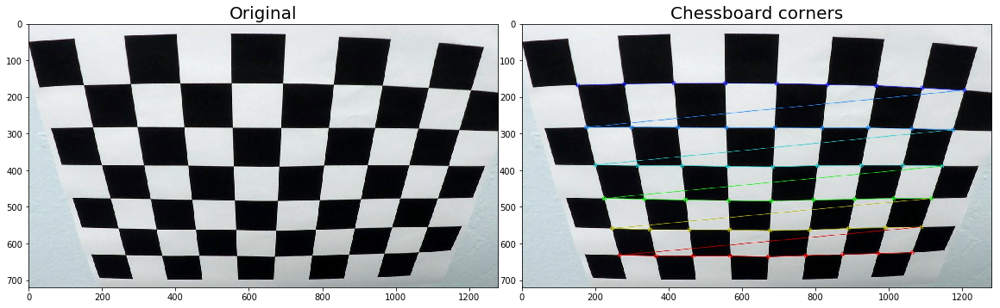

In [10]:
two_imgs_side_by_side(
    'calibration2.jpg',
    'camera_cal', 'Original',
    'output_images/chessboard_corners', 'Chessboard corners'
)

#### 1.0.2. Undistort calibration images (unnecessary step - just to illustrate)

In [41]:
CAM_0.undistort_calibration_imgs('camera_cal', 'output_images/cal_undistorted')

#### 1.0.3. Plot original vs. undistorted

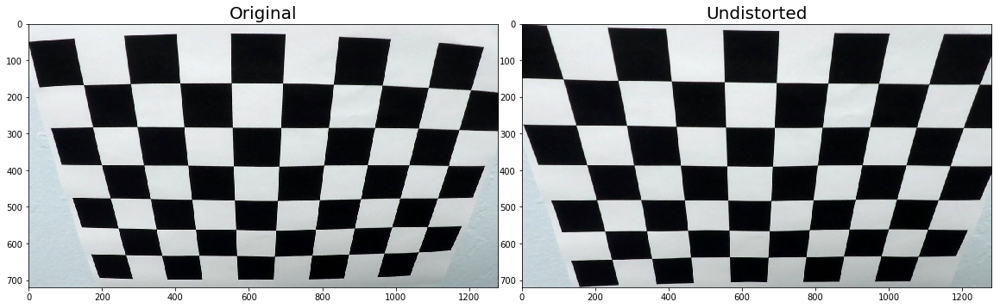

In [12]:
two_imgs_side_by_side(
    'calibration2.jpg',
    'camera_cal', 'Original',
    'output_images/cal_undistorted', 'Undistorted'
)

### 1.1. LaneFindingPipeline setup
#### 1.1.0. LFP initialize & input calibrated camera object

In [17]:
LFP_0 = LaneFindingPipeline()
LFP_0.set_camera(CAM_0)

#### 1.1.1. Setting perspective transforms

In [18]:
LFP_0.set_perspective_transform([[180, 685], [1100, 685], [694, 450], [586, 450]], 450)

### 1.2. Run LaneFindingPipeline through test images

In [19]:
for img, img_fname in ImageIO().imgs_read('test_images'):
    LFP_0.run(img, pipe_single_image=True, out_dir='output_images', img_fname=img_fname)

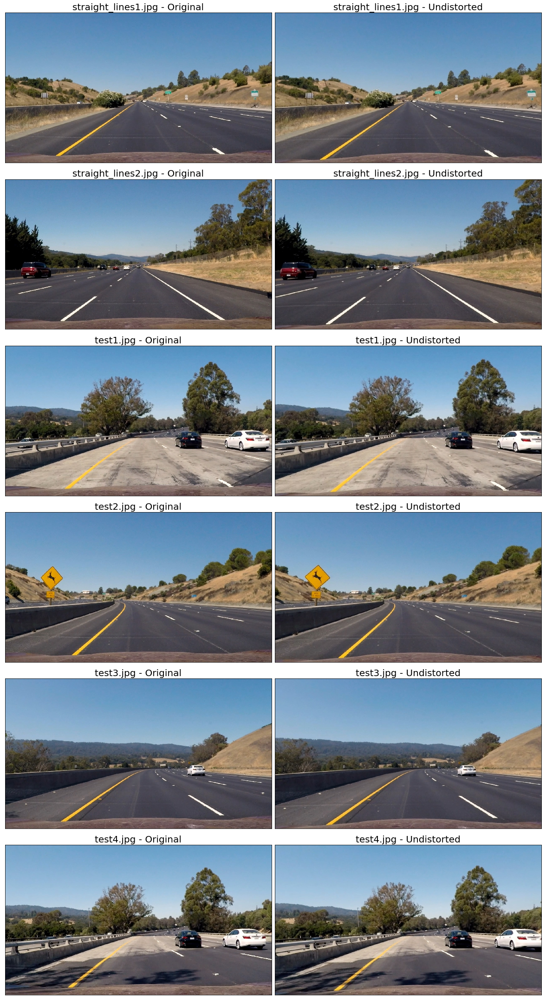

In [16]:
plot_test_images(6, 2,
                 'test_images', 'Original',
                 'output_images/undistorted', 'Undistorted')

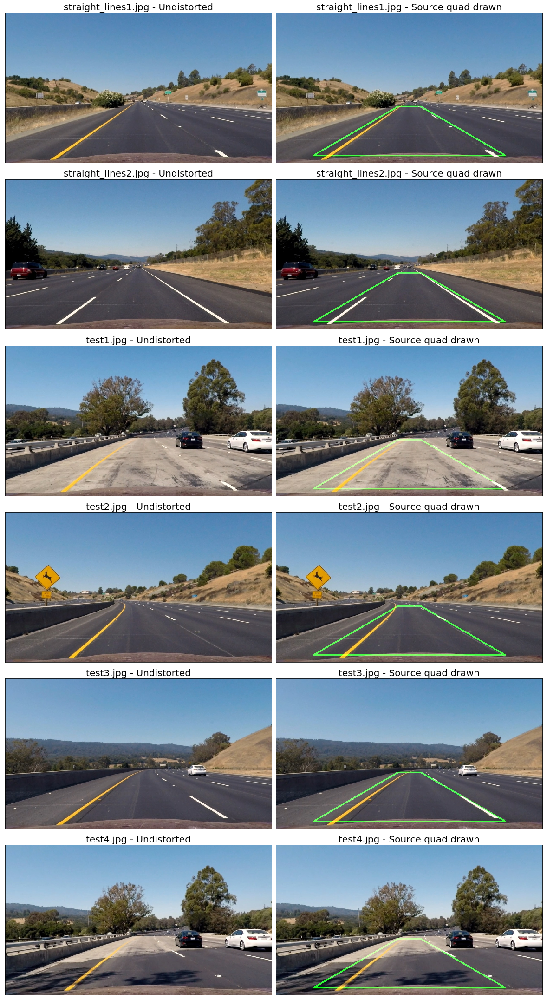

In [17]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/src_quad', 'Source quad drawn')

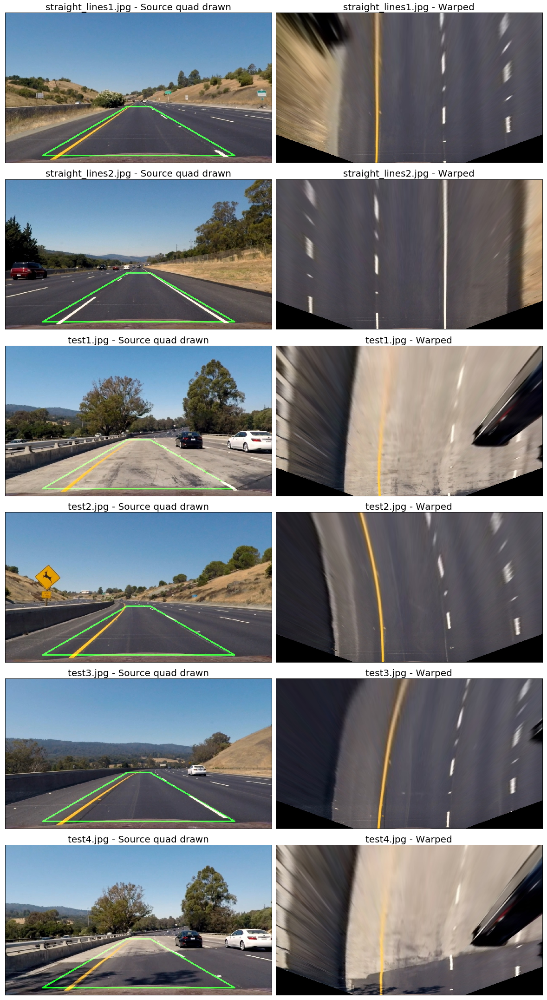

In [18]:
plot_test_images(6, 2,
                 'output_images/src_quad', 'Source quad drawn',
                 'output_images/warped', 'Warped')

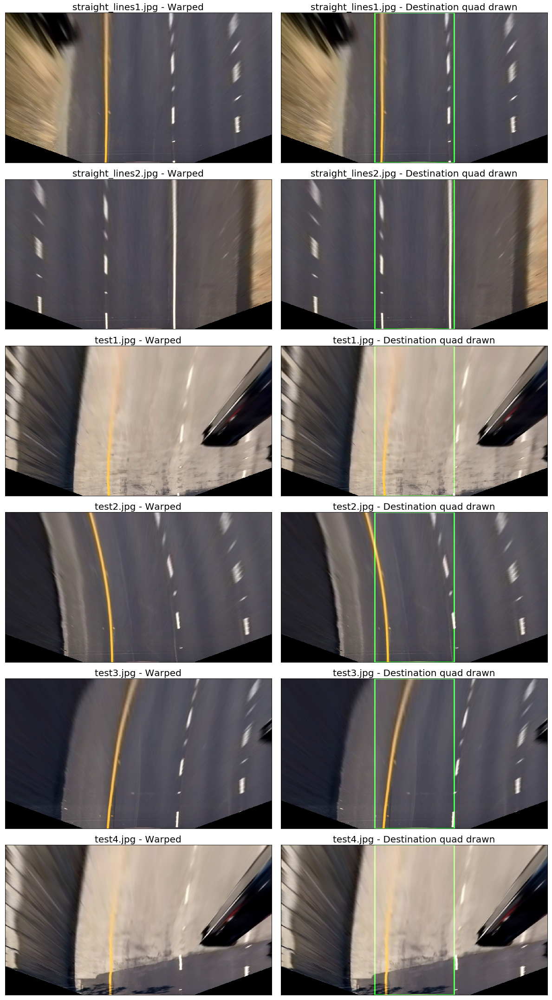

In [19]:
plot_test_images(6, 2,
                 'output_images/warped', 'Warped',
                 'output_images/dst_quad', 'Destination quad drawn')

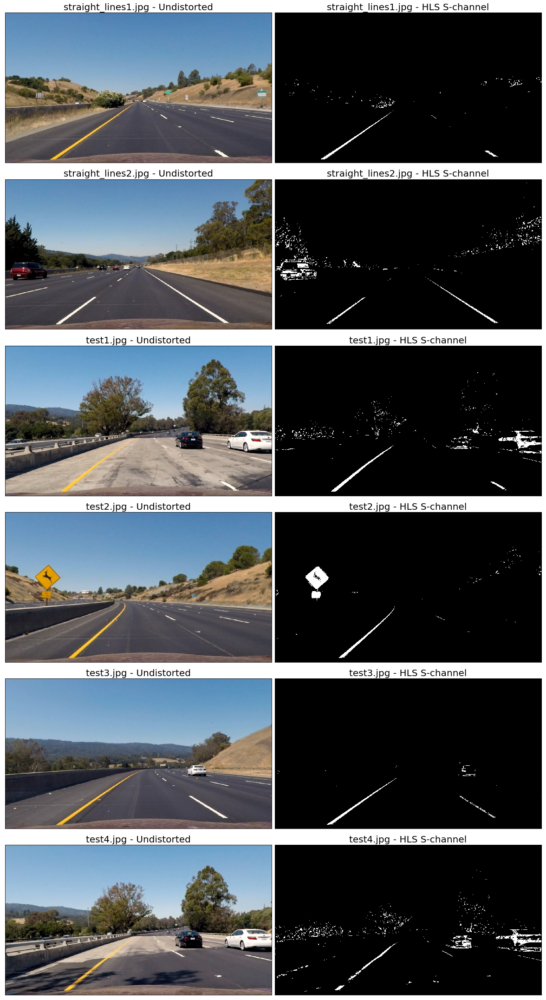

In [20]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/hls_s_thresh', 'HLS S-channel')

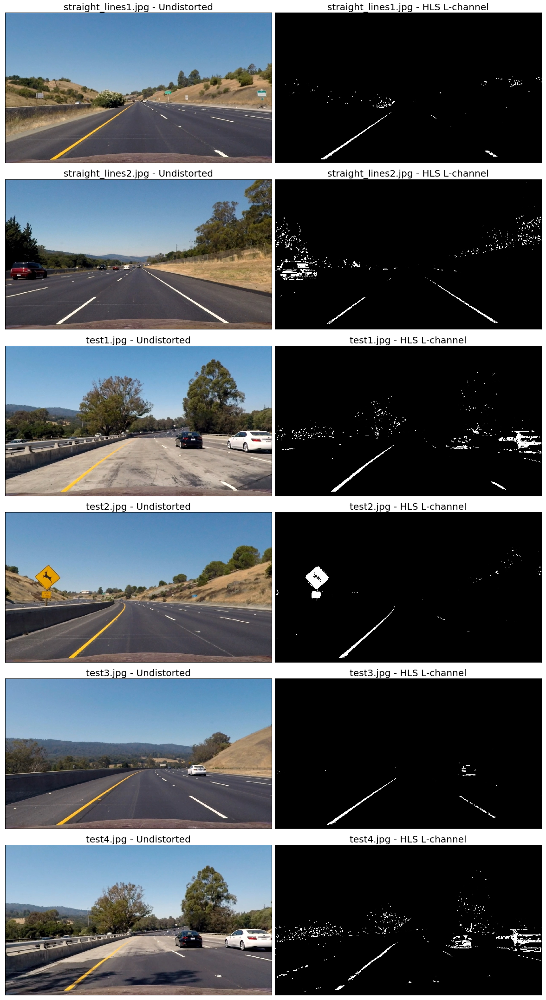

In [21]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/hls_l_thresh', 'HLS L-channel')

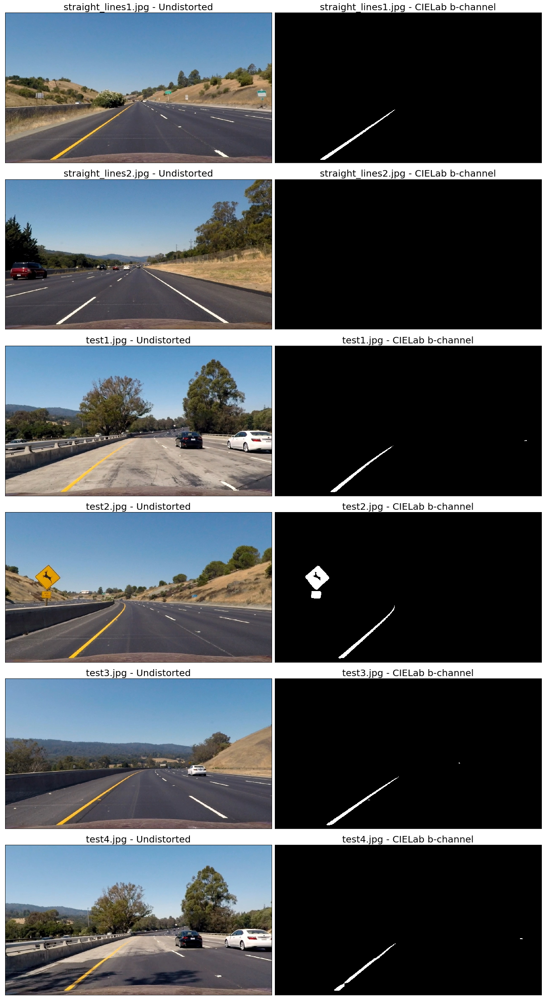

In [22]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/lab_b_thresh', 'CIELab b-channel')

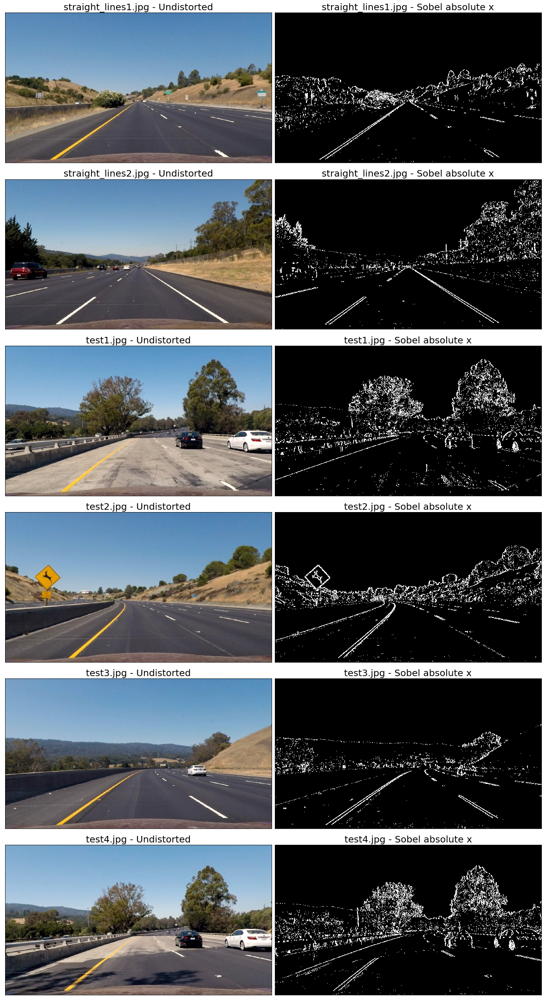

In [23]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/sobel_abs_x', 'Sobel absolute x')

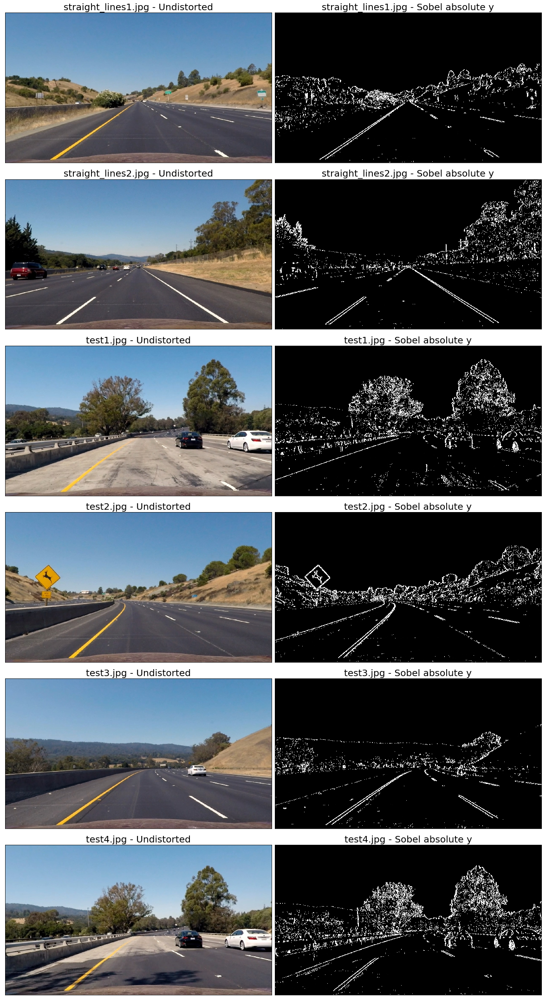

In [24]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/sobel_abs_y', 'Sobel absolute y')

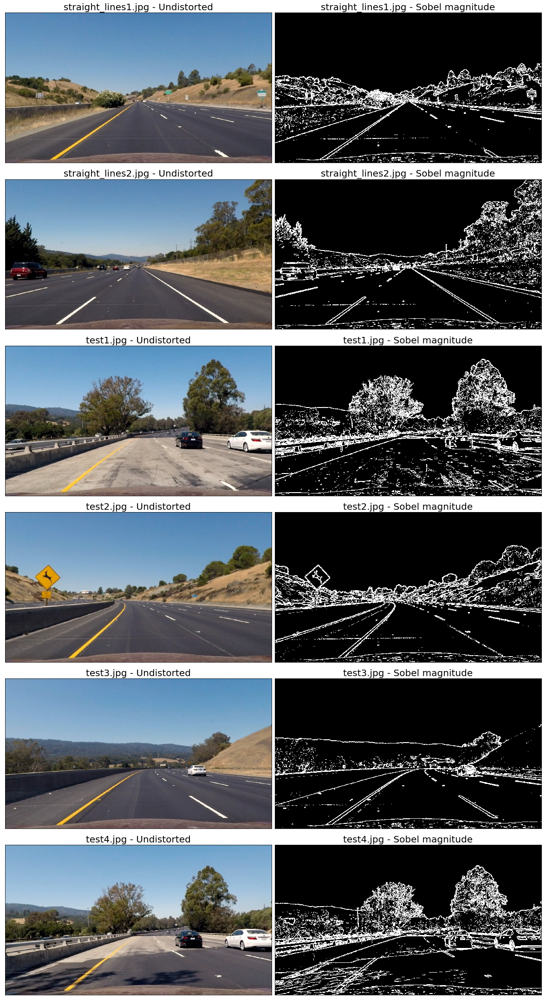

In [25]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/sobel_mag', 'Sobel magnitude')

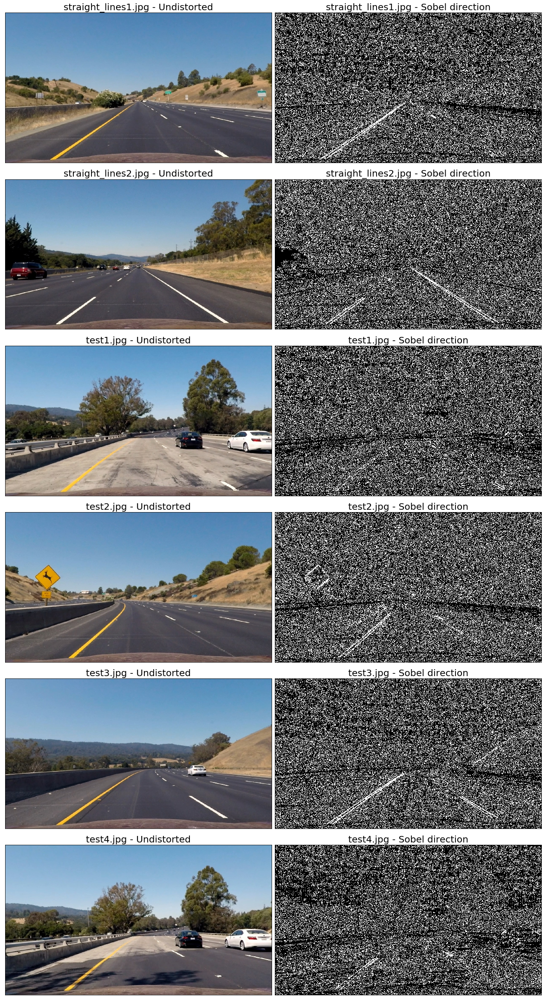

In [26]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/sobel_dir', 'Sobel direction')

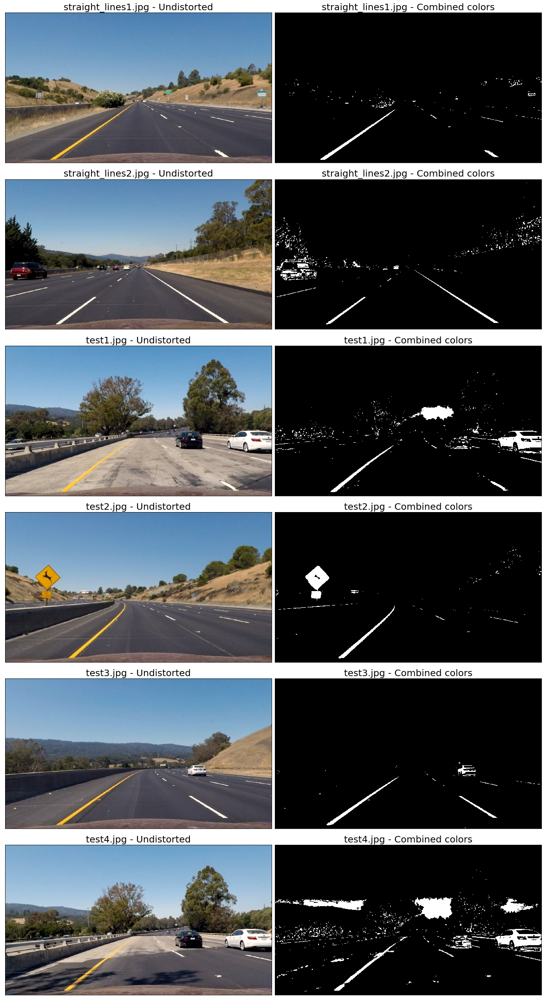

In [27]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/combined_colors', 'Combined colors')

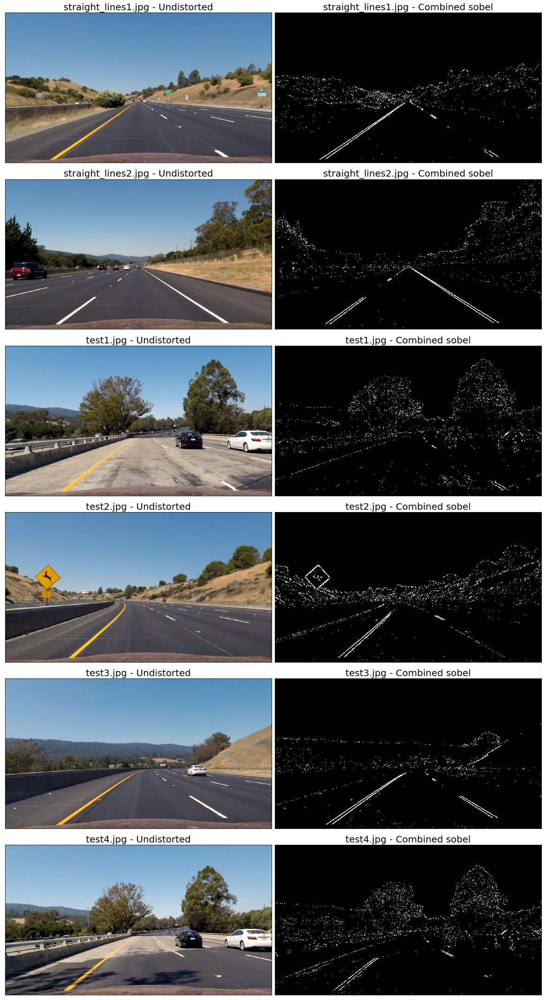

In [28]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/combined_sobel', 'Combined sobel')

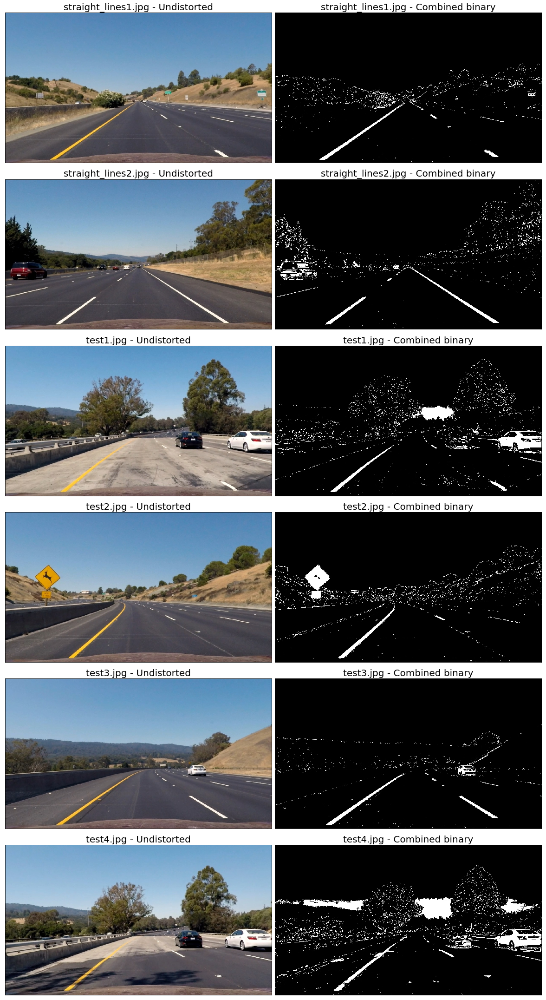

In [29]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/combined_binary', 'Combined binary')

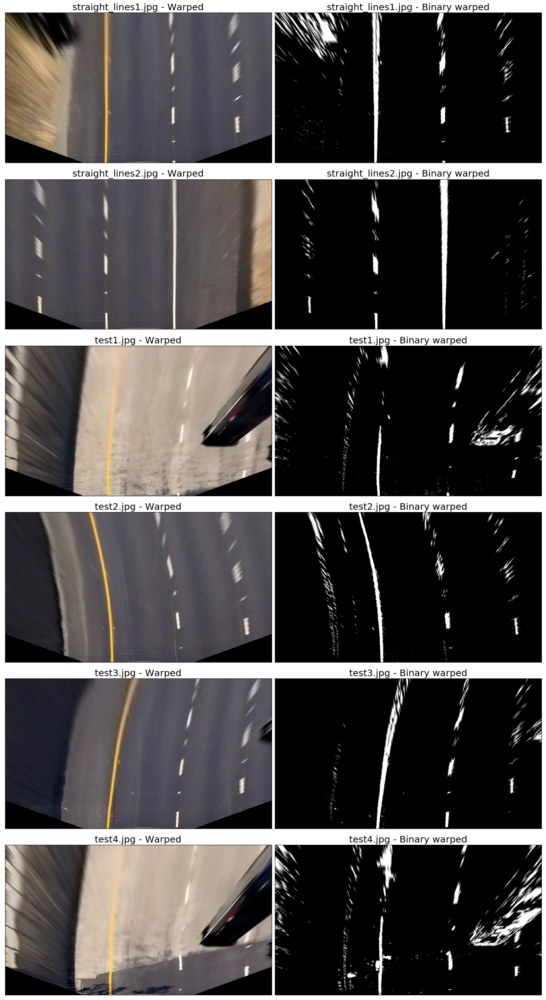

In [30]:
plot_test_images(6, 2,
                 'output_images/warped', 'Warped',
                 'output_images/binary_warped', 'Binary warped')

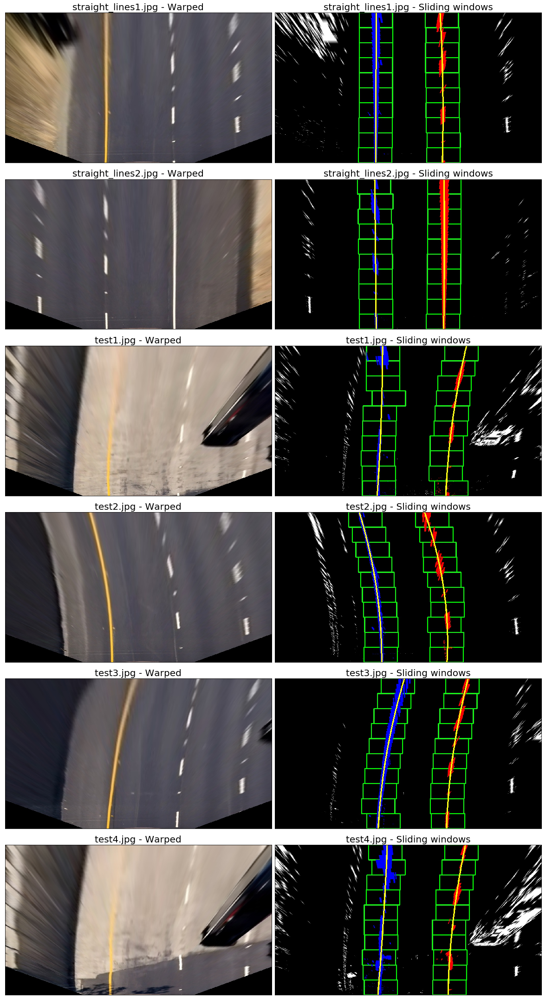

In [31]:
plot_test_images(6, 2,
                 'output_images/warped', 'Warped',
                 'output_images/fit_poly', 'Sliding windows')

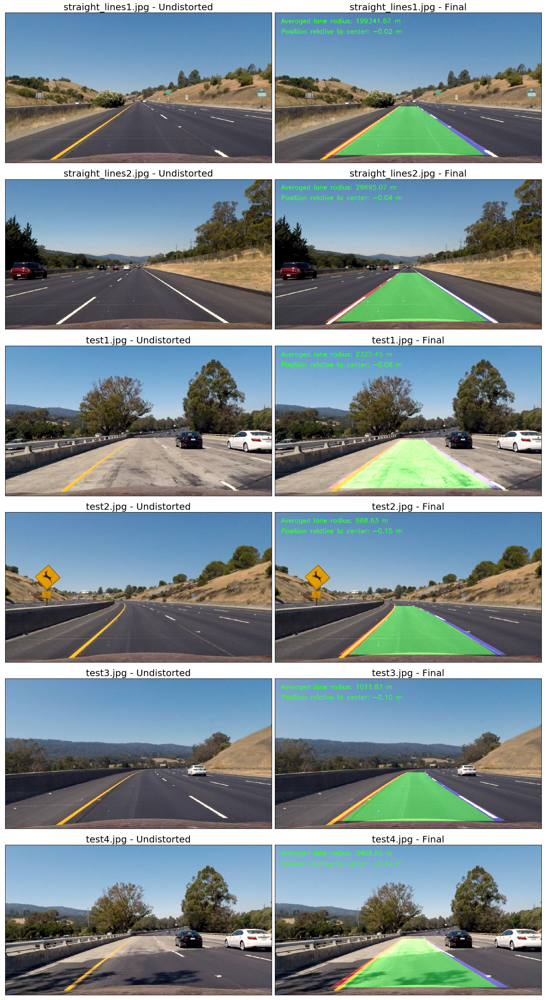

In [32]:
plot_test_images(6, 2,
                 'output_images/undistorted', 'Undistorted',
                 'output_images/final', 'Final')

### 1.3. Run LaneFindingPipeline through project video

In [20]:
from IPython.display import HTML
from moviepy.editor import VideoFileClip

In [21]:
LFP_1 = LaneFindingPipeline()
LFP_1.set_camera(CAM_0)

In [22]:
LFP_1.set_perspective_transform([[180, 685], [1100, 685], [694, 450], [586, 450]], 450)

In [23]:
clip_output = 'project_video_output.mp4'

clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(LFP_1.run)
%time project_clip.write_videofile(clip_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [04:49<00:00,  4.43it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

Wall time: 4min 50s


In [24]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(clip_output))

In [25]:
LFP_2 = LaneFindingPipeline()
LFP_2.set_camera(CAM_0)

In [26]:
LFP_2.set_perspective_transform([[180, 685], [1100, 685], [694, 450], [586, 450]], 450)

In [27]:
clip_output2 = 'challenge_video_output.mp4'

clip2 = VideoFileClip("challenge_video.mp4")
project_clip2 = clip2.fl_image(LFP_2.run)
%time project_clip2.write_videofile(clip_output2, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|████████████████████████████████████████████████████████████████████████████████| 485/485 [01:43<00:00,  4.81it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

Wall time: 1min 44s


In [28]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(clip_output2))

In [29]:
LFP_3 = LaneFindingPipeline()
LFP_3.set_camera(CAM_0)

In [30]:
LFP_3.set_perspective_transform([[180, 685], [1100, 685], [694, 450], [586, 450]], 450)

In [31]:
clip_output3 = 'harder_challenge_video_output.mp4'

clip3 = VideoFileClip("harder_challenge_video.mp4")
project_clip3 = clip3.fl_image(LFP_3.run)
%time project_clip3.write_videofile(clip_output3, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1199/1200 [04:47<00:00,  4.19it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

Wall time: 4min 48s


In [32]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(clip_output3))

## 2. Pipeline setup - private test videos
### 2.0. Resize calibration images

In [33]:
# Samsung Galaxy S8 doesn't allow to lower resolution to 1280x720.
# Default resolution is 4032x2268. Since both resolutions aspect ratio is 16:9,
# it is acceptable to downsize calibration images.
# Selected resolution matches video defaults - HD (1280x720)
CAM_1 = Camera()
CAM_1.imgs_resize(((1280, 720),), 'galaxy_s8/camera_cal/origin', out_dir='galaxy_s8/camera_cal/resized')

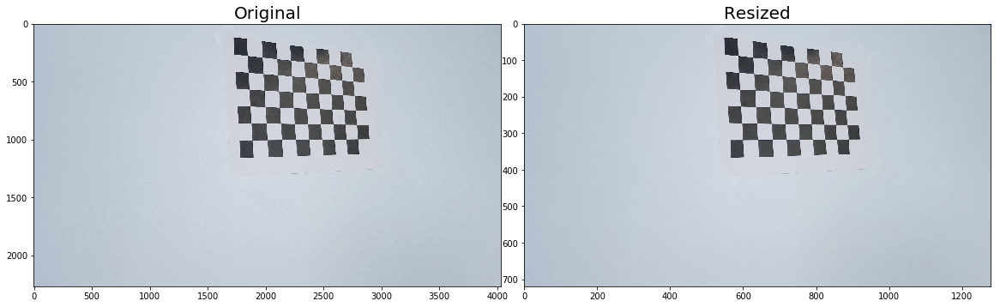

In [22]:
two_imgs_side_by_side(
    'calibration1.jpg',
    'galaxy_s8/camera_cal/origin', 'Original',
    'galaxy_s8/camera_cal/resized', 'Resized'
)

### 2.1. Camera calibration

In [34]:
CAM_1.calibrate('galaxy_s8/camera_cal/resized', (9,6), out_dir='galaxy_s8/camera_cal/chessboard_corners')

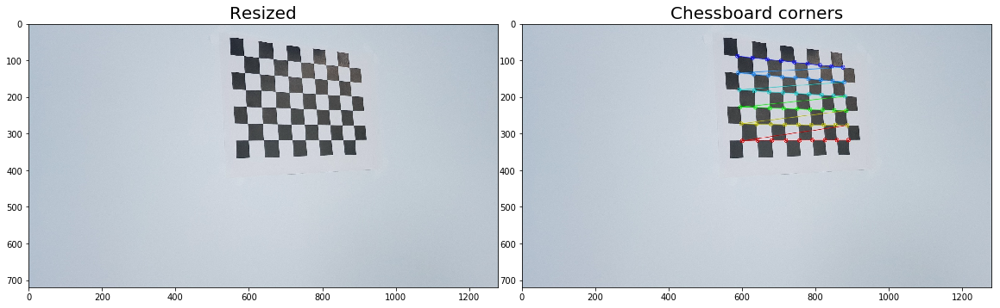

In [12]:
two_imgs_side_by_side(
    'calibration1.jpg',
    'galaxy_s8/camera_cal/resized', 'Resized',
    'galaxy_s8/camera_cal/chessboard_corners', 'Chessboard corners'
)

In [13]:
CAM_1.undistort_calibration_imgs('galaxy_s8/camera_cal/resized', 'galaxy_s8/camera_cal/undistorted')

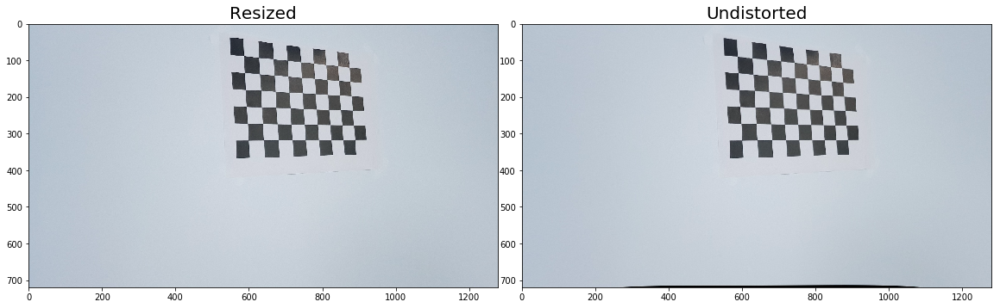

In [14]:
two_imgs_side_by_side(
    'calibration1.jpg',
    'galaxy_s8/camera_cal/resized', 'Resized',
    'galaxy_s8/camera_cal/undistorted', 'Undistorted'
)

### 2.1. LaneFindingPipeline setup
#### 2.1.0. LFP init & input of calibrated camera object

In [35]:
LFP_4 = LaneFindingPipeline()
LFP_4.set_camera(CAM_1)

#### 2.1.1. Setting perspective transforms

In [36]:
LFP_4.set_perspective_transform([[150, 700], [1130, 700], [720, 400], [560, 400]], 400)

In [37]:
clip_output4 = 'private_video_1_output.mp4'

clip4 = VideoFileClip("private_video_1.mp4")
project_clip4 = clip4.fl_image(LFP_4.run)
%time project_clip4.write_videofile(clip_output4, audio=False)

[MoviePy] >>>> Building video private_video_1_output.mp4
[MoviePy] Writing video private_video_1_output.mp4


100%|██████████████████████████████████████████████████████████████████████████████| 1213/1213 [04:19<00:00,  4.62it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: private_video_1_output.mp4 

Wall time: 4min 19s


In [38]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(clip_output4))

In [39]:
LFP_5 = LaneFindingPipeline()
LFP_5.set_camera(CAM_1)

In [40]:
LFP_5.set_perspective_transform([[150, 700], [1130, 700], [720, 400], [560, 400]], 400)

In [41]:
clip_output5 = 'private_video_2_output.mp4'

clip5 = VideoFileClip("private_video_2.mp4")
project_clip5 = clip5.fl_image(LFP_4.run)
%time project_clip5.write_videofile(clip_output5, audio=False)

[MoviePy] >>>> Building video private_video_2_output.mp4
[MoviePy] Writing video private_video_2_output.mp4


100%|█████████████████████████████████████████████████████████████████████████████▉| 1941/1942 [06:34<00:00,  4.65it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: private_video_2_output.mp4 

Wall time: 6min 34s


In [42]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(clip_output5))